# What to do with thousands of neurons in visual cortex?  

# 0. Loading and preparing. 

### Load in the Python libraries

In [2]:
import os # os stands for "operating system" and includes read/write routines etc. 
import numpy as np # by far the most used library for everyday computation
from scipy import stats # here we import a whole sub-library of stats functions
from scipy.ndimage import gaussian_filter, gaussian_filter1d # here we import a single function
from sklearn.decomposition import PCA # check out all the other dimensionality reduction methods in "decomposition"
from matplotlib import pyplot as plt # all of our plotting is done with plt
%matplotlib inline 
# %matplotlib notebook # if you need to zoom into a figure, this is the "interactive" mode of IPython

# this function performs a running average filter over the first dimension of X
# (faster than doing gaussian filtering)
def running_average(X, nbin = 100):
    Y = np.cumsum(X, axis=0)
    Y = Y[nbin:, :] - Y[:-nbin, :]
    return Y

# * set root to the location where you downloaded the data *
root      = 'C:/Users/hamed/Desktop/Hamed/test/data/9505250'

# LOAD the visual stimuli "mov" and the timings "iframe"
mov    = np.load(os.path.join(root, 'mov.npy')) # these are the visual stimuli shown
iframe = np.load(os.path.join(root, 'iframe.npy')) # iframe[n] is the microscope frame for the image frame n

# LOAD the neural data
spks = np.load(os.path.join(root, 'spks.npy')) # deconvolved data
stat = np.load(os.path.join(root, 'stat.npy'), allow_pickle=True) # these are the per-neuron stats returned by suite2p
# these are the neurons' 2D coordinates
ypos = np.array([stat[n]['med'][0] for n in range(len(stat))]) 
# (notice the python list comprehension [X(n) for n in range(N)])
xpos = np.array([stat[n]['med'][1] for n in range(len(stat))]) 

del stat # we delete stat because we don't need any other fields from it


FileNotFoundError: [Errno 2] No such file or directory: 'C:/Users/hamed/Desktop/Hamed/test/data/9505250\\mov.npy'

### Align stimuli and neural data

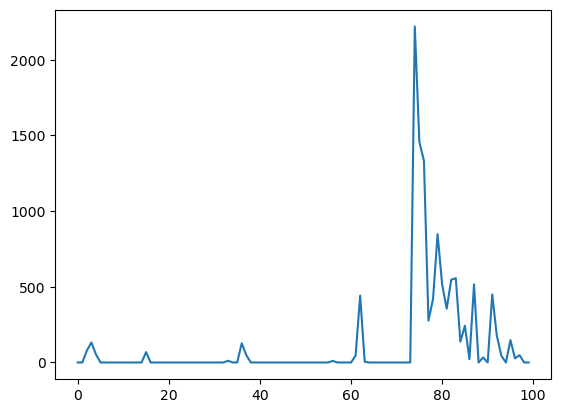

In [23]:
# align stimuli to spks (since stimuli are triggered by microscope it's easy)
dt = 1 # time offset between stimulus presentation and response
ivalid = iframe+dt<spks.shape[-1] # remove timepoints outside the valid time range
iframe = iframe[ivalid]
mov = mov[:, :, ivalid]
S = spks[:, iframe+dt]
del spks
S = stats.zscore(S, axis=1) # z-score the neural activity before doing anything

# 1. Single neuron receptive fields

Let's first look at the positions of the neurons.

Text(0, 0.5, 'Y position (um)')

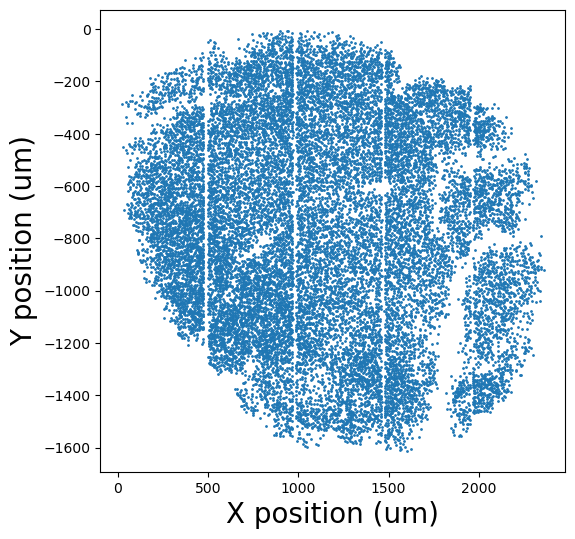

In [24]:
# POSITIONS OF ALL NEURONS
plt.figure(figsize=(6,6))
plt.scatter(xpos, -ypos, s = 1)
plt.xlabel('X position (um)', fontsize=20)
plt.ylabel('Y position (um)', fontsize=20)

And what does the stimulus look like on each frame?

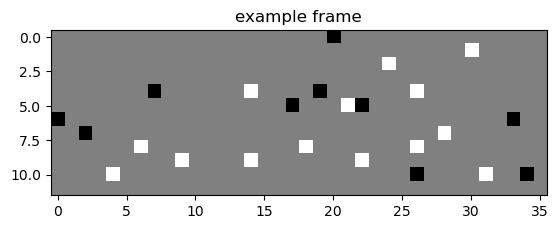

In [25]:
# STIMULUS FRAME
plt.figure()
plt.imshow(mov[:,:,100], cmap='gray')
plt.title('example frame')
plt.show()

Text(0.5, 0, 'time points')

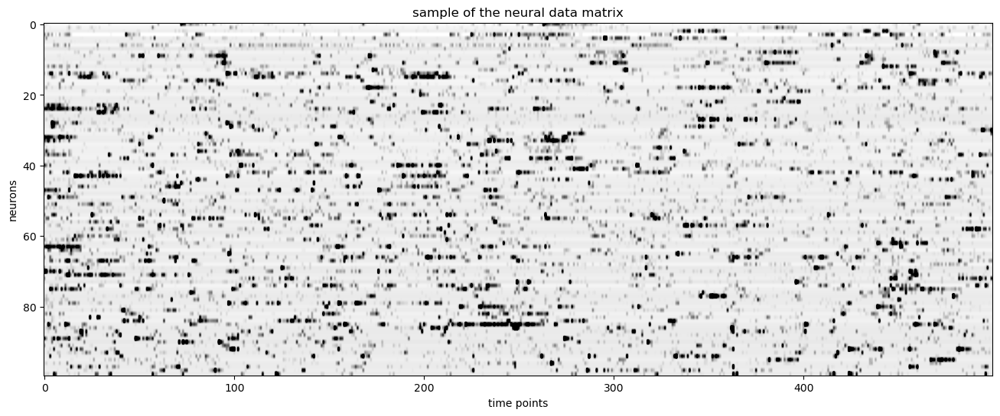

In [26]:
plt.figure(figsize=(16,6))
plt.imshow(S[:100, :500], vmax = 3, vmin = -0.5, aspect='auto', cmap = 'gray_r')
plt.title('sample of the neural data matrix')
plt.ylabel('neurons') 
plt.xlabel('time points')

### First, compute ordinary ON - OFF receptive fields for each neuron

In [27]:
NN, NT = S.shape 

X = np.reshape(mov, [-1, NT]) # reshape to Npixels by Ntimepoints
X = X-0.5 # center at 0
#X = np.abs(X-0.5) # center at 0
X = stats.zscore(X, axis=1)/NT**.5  # z-score each pixel separately
npix = X.shape[0]

lam = 0.01 # regularizer for ridge regression
B0 = np.linalg.solve((X @ X.T + lam * np.eye(npix)),  (X @ S.T)) # get the receptive fields for each neuron
        
B0 = np.reshape(B0, [mov.shape[0], mov.shape[1], NN])
B0 = gaussian_filter(B0, [.5, .5, 0]) # smooth each receptive field a little

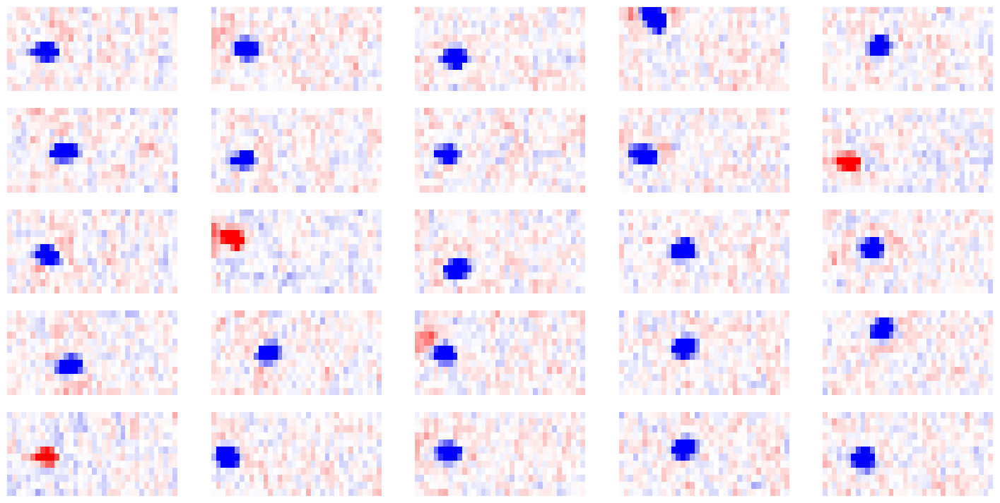

In [28]:
Spred = np.reshape(B0, (-1,NN)).T @ X
Spred -= S
varexp = 1.0 - (Spred**2).mean(axis=-1)
asort = np.argsort(varexp)[::-1]

plt.figure(figsize=(18, 9))
for j in range(5*5):
    plt.subplot(5,5,j+1)
    plt.imshow(B0[:,:,asort[j]], aspect='auto', vmin=-6, vmax=6, cmap = 'bwr') # plot the receptive field for each neuron
    plt.axis('off')  
plt.show()

### Now let's compute ON + OFF receptive fields

In [29]:
X = np.abs(X) # response is the same for ON and OFF squares (WHITE OR BLACK)

X = stats.zscore(X, axis=1)/NT**.5  # z-score each pixel separately
lam = 0.01 # regularizer for ridge regression
B0 = np.linalg.solve((X @ X.T + lam * np.eye(npix)),  (X @ S.T)) # get the receptive fields for each neuron
        
B0 = np.reshape(B0, [mov.shape[0], mov.shape[1], NN])
B0 = gaussian_filter(B0, [.5, .5, 0]) # smooth each receptive field a little

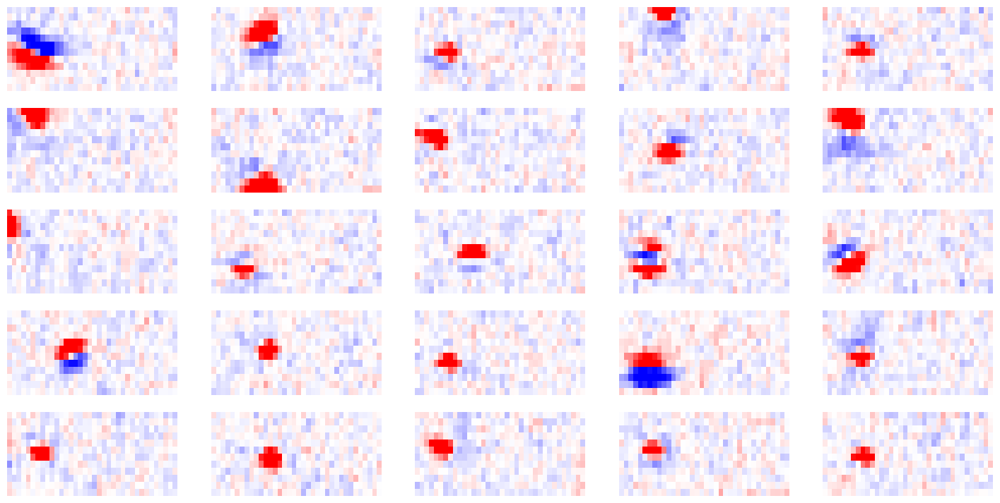

In [30]:
Spred = np.reshape(B0, (-1,NN)).T @ X
Spred -= S
varexp = 1.0 - (Spred**2).mean(axis=-1)
asort = np.argsort(varexp)[::-1]

plt.figure(figsize=(18, 9))
for j in range(5*5):
    plt.subplot(5,5,j+1)
    plt.imshow(B0[:,:,asort[j]], aspect='auto', vmin=-6, vmax=6, cmap = 'bwr') # plot the receptive field for each neuron
    plt.axis('off')   
plt.show()

## Average over RFs in local region

Create distance matrix and then average neurons within 50 um of each neuron.

In [31]:
deltay = ypos[:, np.newaxis] - ypos # np.newaxis creates a new axis
deltax = xpos[:, np.newaxis] - xpos # a vector of N by 1 can broadcast with a vector of 1 by N to give a matrix N by N
ds = (deltay**2 + deltax**2)**.5 # **2 means elementwise squaring
del deltay, deltax

# find all neurons within 50 um and average over their RFs
sig = 50 # spatial scale for smoothing
B = np.zeros(B0.shape)
for j in range(NN):
    ix = ds[:,j]<sig
    B[:,:,j] = np.mean(B0[:,:,ix], axis=-1) # average receptive fields within sig
    

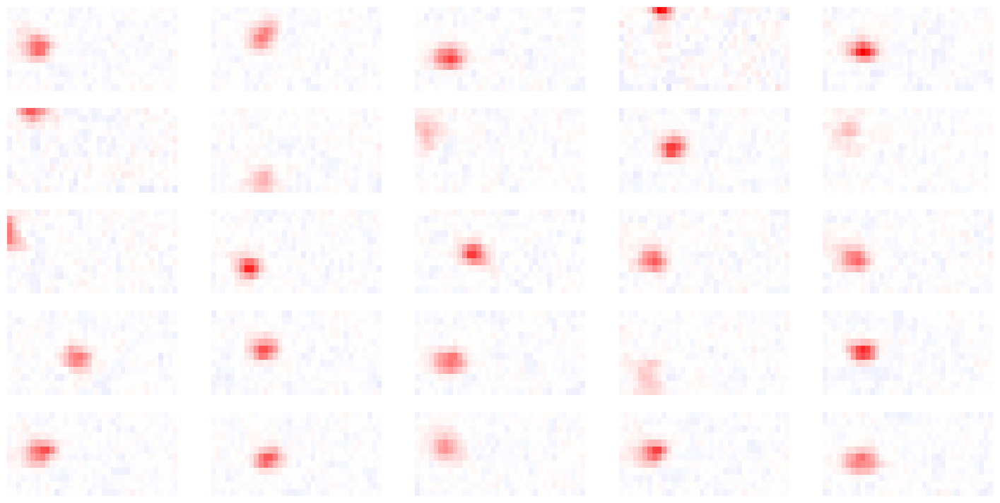

In [32]:
Spred = np.reshape(B0, (-1,NN)).T @ X
Spred -= S
varexp = 1.0 - (Spred**2).mean(axis=-1)
asort = np.argsort(varexp)[::-1]

plt.figure(figsize=(18, 9))
for j in range(5*5):
    plt.subplot(5,5,j+1)
    plt.imshow(B[:,:,asort[j]], aspect='auto', vmin=-6, vmax=6, cmap = 'bwr') # plot the receptive field for each neuron
    plt.axis('off')
    
plt.show()

Create retinotopy. Take the max of each averaged receptive field and use as receptive field location.

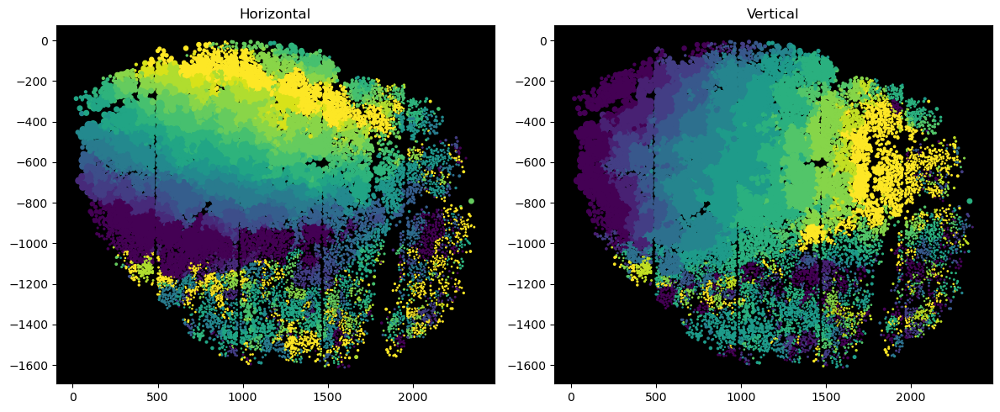

In [33]:
imax = np.argmax(np.reshape(B, [-1,NN]), axis=0) # find the pixel corresponding to the max response for each cell
ly, lx, nstim = mov.shape

# xmax, ymax = np.unravel(imax, (ly, lx)) # unravel an index for a (1,ly*lx) array, to two indices for an (ly, lx) array
xmax = np.minimum(17, imax%lx)
ymax = (imax/lx).astype('int')

plt.figure(figsize=(12,5))
Amax = np.max(B, axis=(0,1)) - np.min(B, axis=(0,1))
plt.subplot(1,2,1, facecolor=[0, 0, 0])
plt.scatter(xpos, -ypos, s = (Amax)**2, c = xmax, cmap='viridis')
plt.title('Horizontal')

plt.subplot(1,2,2, facecolor=[0, 0, 0])
plt.scatter(xpos, -ypos, s = (Amax)**2, c = ymax, cmap='viridis')
plt.title('Vertical')

plt.tight_layout()

plt.show()

# 2. Dimensionality reduction: what are the dominant patterns of activity?

Let's look at the top PCs

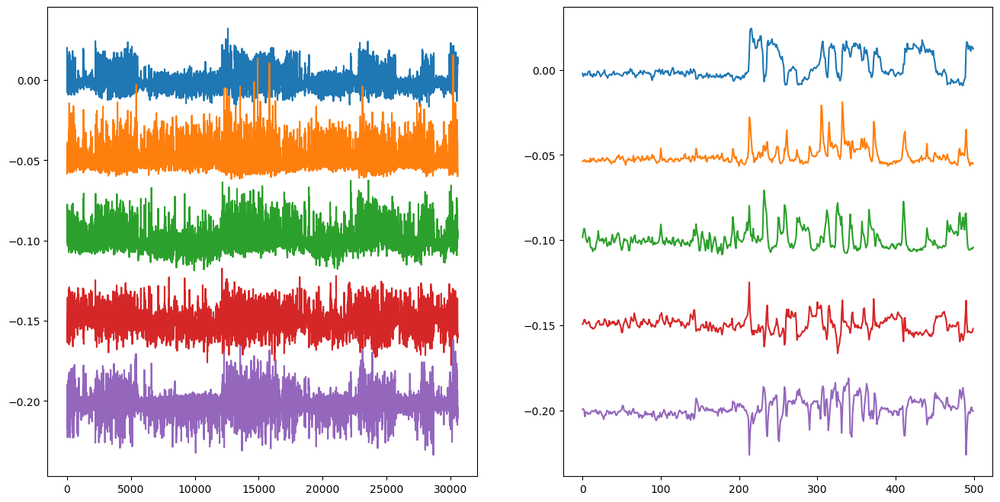

In [34]:
# show that components do not necessarily have receptive fields
from sklearn.decomposition import PCA
model = PCA(n_components = 100)
model.fit(S)

# plot some components
X = model.components_

plt.figure(figsize=(16,8))
plt.subplot(1,2,1)
for j in range(5):
    plt.plot(X[j] - j * .05)
plt.subplot(1,2,2)
for j in range(5):
    plt.plot(X[j, 2000:2500] - j * .05)
plt.show()

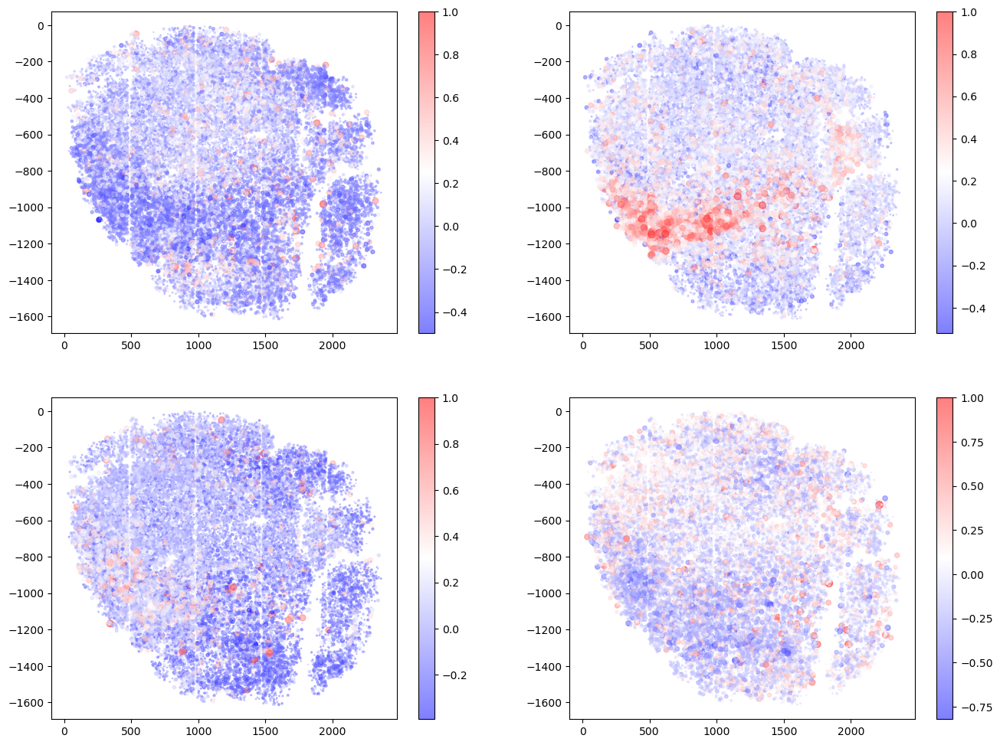

In [35]:
# HERE color cells according to their PC weights
plt.figure(figsize=(16,12))
for j in range(4):
    pc0 = S @ model.components_[j]
    pc0 = pc0/np.max(np.abs(pc0))
    lam = np.abs(pc0)    
    plt.subplot(2,2,1+j)
    plt.scatter(xpos, -ypos, s = 50 * lam, c = pc0, cmap='bwr', alpha = .5)
    plt.colorbar()

Receptive fields of the PCs:

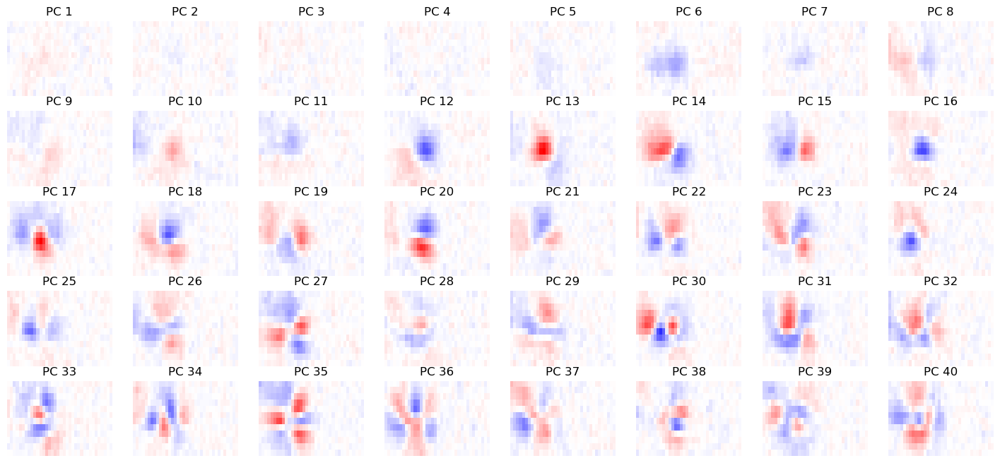

In [36]:
from scipy.stats import zscore
Sp = model.components_
Sp = zscore(Sp, axis=1)
ly, lx, nstim = mov.shape

NN, NT = S.shape 

X = np.reshape(mov, [-1, NT]) # reshape to Npixels by Ntimepoints
X = X-0.5 # subtract the background
X = np.abs(X) # does not matter if a pixel is black (0) or white (1)
X = stats.zscore(X, axis=1)/NT**.5  # z-score each pixel separately
npix = X.shape[0]

lam = .0001
ncomps = Sp.shape[0]
B0 = np.linalg.solve((X @ X.T + lam * np.eye(npix)),  (X @ Sp.T)) # get the receptive fields for each neuron

B0 = np.reshape(B0, (ly, lx, ncomps))
B0 = gaussian_filter(B0, [.5, .5, 0]) # smooth each receptive field a little

plt.figure(figsize=(18, 8))
rfmax = np.max(B0)
for j in range(40):
    plt.subplot(5,8,j+1)
    rf = B0[:,:,j]
    # rfmax = np.max(np.abs(rf))
    plt.imshow(rf, aspect='auto', cmap = 'bwr', vmin = -rfmax, vmax = rfmax) # plot the receptive field for each neuron
    plt.title('PC %d'%(1+j))
    plt.axis('off')
    
plt.show()    

## Two mysteries

1. Why don't the top PCs have receptive fields?
2. Why do the PC receptive fields look like that?
    - PCs of translation-invariant data always look like that


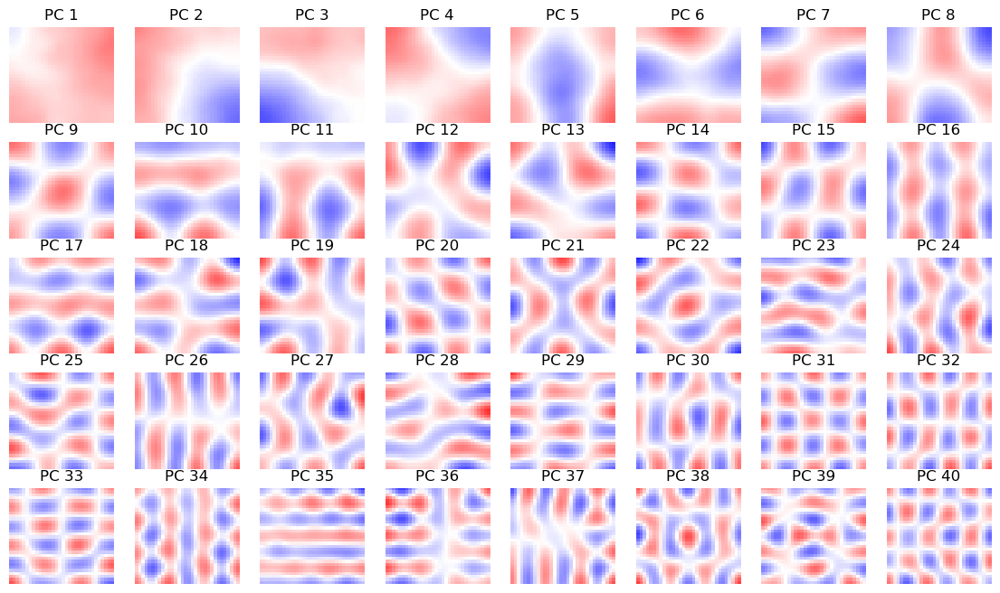

In [37]:
# solve the second mystery: PCA of translation-invariant data always looks like that
# make some random noise and smooth it
nPC = 50

Xn = np.random.randn(10000, 32,32)
Xn = gaussian_filter(Xn, [0, 2, 2])
Xn = np.reshape(Xn, (10000, -1))
model = PCA(n_components= nPC).fit(Xn)

bPC = np.reshape(model.components_.T, (32,32, nPC))
plt.figure(figsize=(14, 8))
rfmax = np.max(bPC)
for j in range(40):
    plt.subplot(5,8,j+1)
    rf = bPC[:,:,j]
    # rfmax = np.max(np.abs(rf))
    plt.imshow(rf, aspect='auto', cmap = 'bwr', vmin = -rfmax, vmax = rfmax) # plot the receptive field for each neuron
    plt.title('PC %d'%(1+j))    
    plt.axis('off')
plt.show()    

# compare with DCT https://en.wikipedia.org/wiki/Discrete_cosine_transform
del Xn    

# 3. Rastermap

Rastermap re-arranges neurons in the raster plot based on similarity of activity

We can first run rastermap in suite2p and then in the notebook.

In [21]:


from rastermap import Rastermap

# we run rastermap the same way that the other scikit-learn embedding algorithms work
model = Rastermap(n_components=1, n_X=100).fit(S) 

ModuleNotFoundError: No module named 'rastermap'

In [39]:
np.shape(S)



(18795, 30560)

NameError: name 'd' is not defined

In [41]:
# the manifold embedding is in model.embedding
isort = np.argsort(model.embedding[:,0])

# sort by embedding and smooth over neurons
Sfilt = running_average(S[isort, 2000:2500], 50)
Sfilt = stats.zscore(Sfilt, axis=1)


In [42]:
print(np.shape(model.embedding))

(18795, 1)


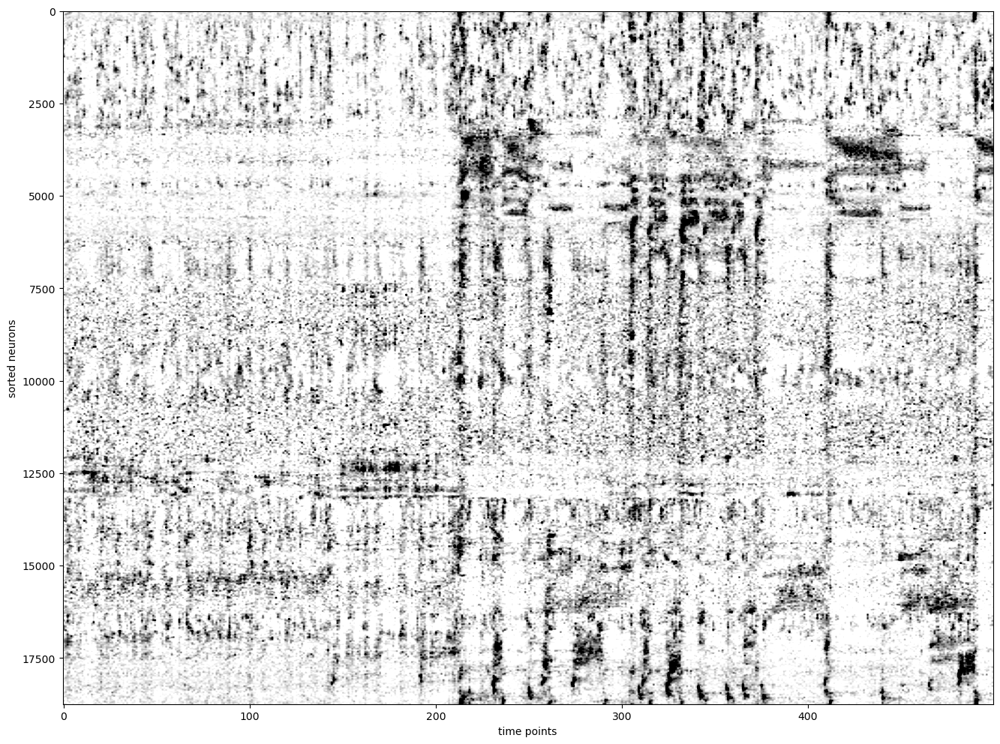

In [43]:
plt.figure(figsize=(16,12))
plt.imshow(Sfilt, vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r')
plt.xlabel('time points')
plt.ylabel('sorted neurons')
plt.show()

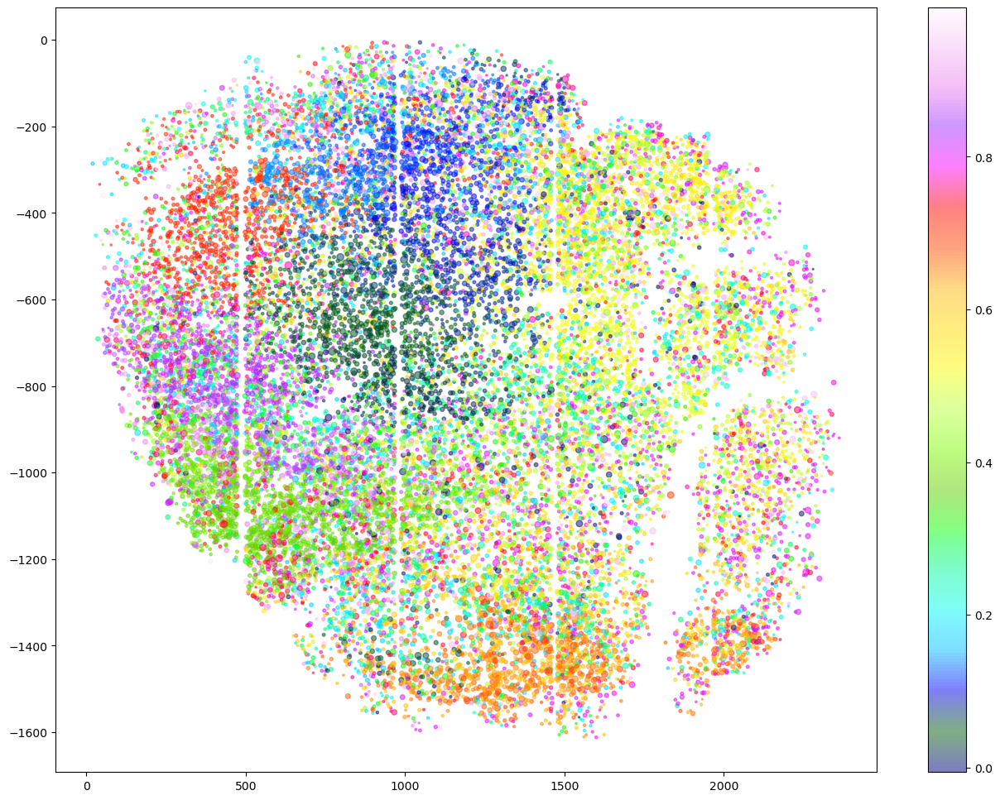

In [44]:
# HERE color cells according to their rastermap embedding
lam=model.lam
plt.figure(figsize=(16,12))
plt.scatter(xpos, -ypos, s=50*lam/np.max(lam), c=model.embedding[:,0], 
            cmap='gist_ncar', alpha = .5)
plt.colorbar()
plt.show()

Do the rastermap components have receptive fields?

In [45]:
NN, NT = S.shape 

# reshape and sum S across neurons to get "components"
nc = 100
NC = int(np.floor(NN / nc))
Sp = np.reshape(S[isort][:nc*NC], (NC, nc, NT))
Sp = Sp.mean(axis=1)

ly, lx, nstim = mov.shape

X = np.reshape(mov, [-1, NT]) # reshape to Npixels by Ntimepoints
X = np.abs(X-0.5) # does not matter if a pixel is black (0) or white (1)
X = stats.zscore(X, axis=1)/NT**.5  # z-score each pixel separately
npix = X.shape[0]

lam = .01
ncomps = Sp.shape[0]
B0 = np.linalg.solve((X @ X.T + lam * np.eye(npix)),  (X @ Sp.T)) # get the receptive fields for each neuron

B0 = np.reshape(B0, (ly, lx, ncomps))
B0 = gaussian_filter(B0, [.5, .5, 0]) # smooth each receptive field a little

(432, 30560)

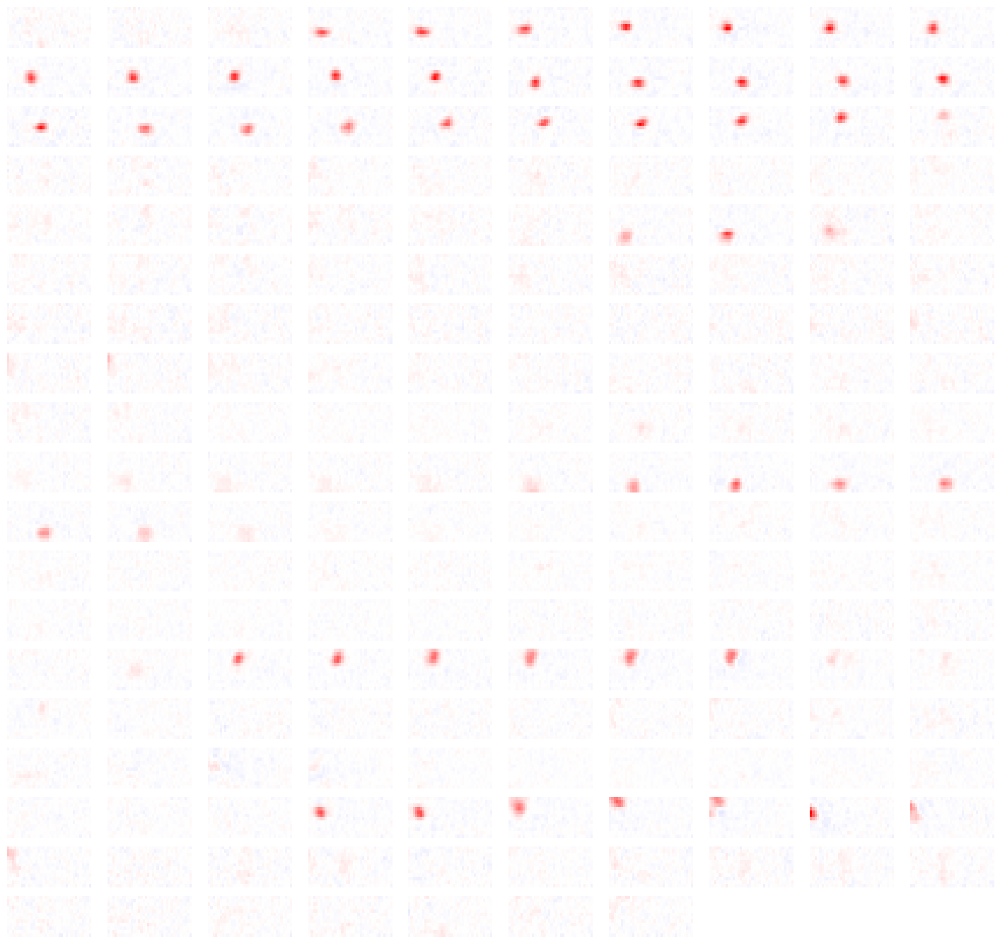

In [46]:
# plot receptive fields
plt.figure(figsize=(18, 18))
rfmax = np.max(B0)
for j in range(0, B0.shape[-1]):
    plt.subplot(20,10,j+1)
    rf = B0[:,:,j]
    # rfmax = np.max(np.abs(rf))
    plt.imshow(rf, aspect='auto', cmap = 'bwr', vmin = -rfmax, vmax = rfmax) # plot the receptive field for each neuron    
    plt.axis('off')
    
plt.show()    

# 4. Behavioral analysis

What are these other groups of neurons responding to?

In [47]:
# LOAD IN BEHAVIORAL DATA
proc = np.load(os.path.join(root, 'cam1_TX39_2019_05_31_1_proc_resampled.npy'), allow_pickle=True).item()
motSVD = proc['motSVD'][:,iframe+dt]
parea = proc['pupil']['area'][0][iframe+dt].copy()

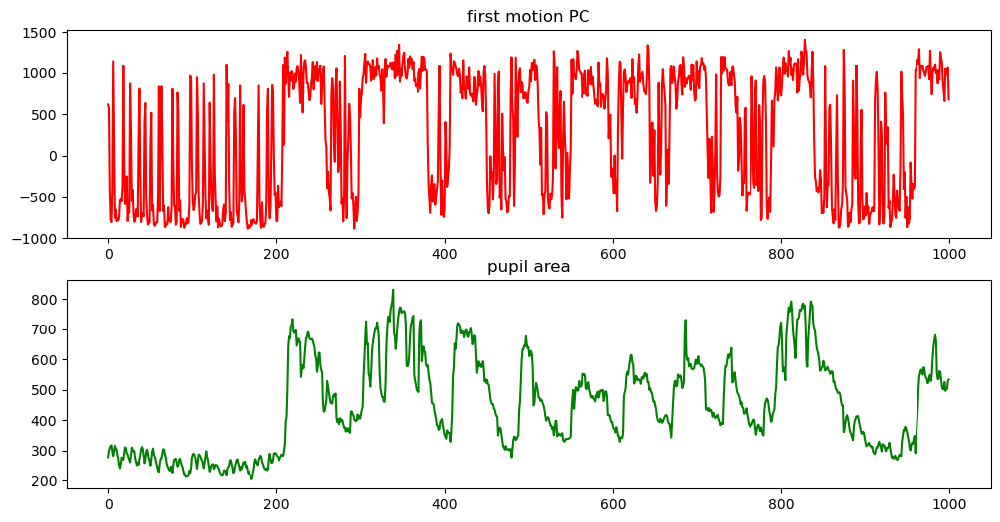

In [48]:
plt.figure(figsize=(12,6))
plt.subplot(2,1,1)
plt.plot(motSVD[0,2000:3000]*-1, color='r')
plt.title('first motion PC')

plt.subplot(2,1,2)
plt.plot(parea[2000:3000], color='g')
plt.title('pupil area')
plt.show()

### Bin neural and behavioral data
We will bin the neural activity and the behavior (1 second bins)

In [49]:
# bin data
tbin = 3.0
NT = motSVD.shape[1]
nt = int(np.floor(NT/tbin))
motSVD -= motSVD.mean(axis=1)[:,np.newaxis]
parea  -= np.nanmean(parea)
parea[np.isnan(parea)] = 0
tbin = int(tbin)

beh = np.reshape(motSVD[:,:nt*tbin], (motSVD.shape[0], nt, tbin)).mean(axis=-1)
pup = np.reshape(parea[:nt*tbin], (nt, tbin)).mean(axis=-1)

# using this format bin S
Sbin = np.reshape(S[:,:nt*tbin], (S.shape[0], nt, tbin)).mean(axis=-1)
Spbin = np.reshape(Sp[:,:nt*tbin], (Sp.shape[0], nt, tbin)).mean(axis=-1)

# use PCs of neural activity
model = PCA(n_components=64).fit(Sbin)
V = model.components_ # time components
sv = model.singular_values_
U = np.matmul(Sbin,V.T) / sv # neuron components
V *= sv[:,np.newaxis]

np.shape(V.T)

We have to do a train-test split to do prediction

C:\Users\hamed\AppData\Local\Temp\ipykernel_19404\2253817000.py:7: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  itrain = np.ones(nt, np.bool)


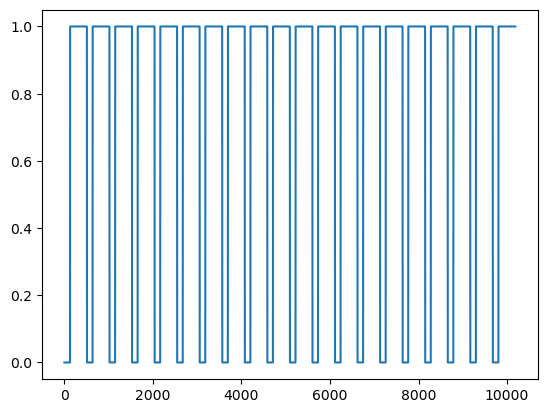

In [50]:
# split into train-test
# * use interleaved segments *
nsegs = 20
nlen  = nt/nsegs
ninds = np.linspace(0,nt-nlen,nsegs).astype(int)
itest = (ninds[:,np.newaxis] + np.arange(0,nlen*0.25,1,int)).flatten()
itrain = np.ones(nt, np.bool)
itrain[itest] = 0

plt.plot(itrain)
plt.show()

Can you determine how I did the split above? Why might I have split into segments rather than randomly interleaving time-points?

# Prediction with behavioral variables

Use linear regression to perform the prediction, predict $Y$ using $X$:

$$ A = (X_\text{train}X_\text{train}^\top)^{-1} (X_\text{train} Y_\text{train}^\top)$$

$X$ is behavioral components by time, $Y$ is neural components by time. If you want to regularize the linear regression:

$$ A = (X_\text{train}X_\text{train}^\top + \lambda I)^{-1} (X_\text{train} Y_\text{train}^\top)$$

Then the prediction on time points is:

$$ \hat Y_\text{test} = A^\top X_\text{test} $$

In [57]:
A = np.matmul(pup[itrain], V[:,itrain].T)/(pup**2).sum()
np.shape(V[:,itrain].T)

(7626, 64)

In [ ]:
covM = np.matmul(beh[:,itrain], beh[:,itrain].T)

(beh.shape)

(500, 10186)

In [ ]:
#### PREDICT USING PUPIL WITH LINEAR REGRESSION

A = np.matmul(pup[itrain], V[:,itrain].T)/(pup**2).sum()

Vpredp = np.matmul(A[:,np.newaxis], pup[itest][np.newaxis,:])

varexp_pupil = 1 - ((Vpredp - V[:,itest])**2).sum(axis=1)/(V[:,itest]**2).sum(axis=1)

#### PREDICT USING BEHAVIOR PC'S 
## regularized linear regression from behavior to neural PCs
covM = np.matmul(beh[:,itrain], beh[:,itrain].T)
lam = 1e5 # regularizer
covM += lam*np.eye(beh.shape[0])
A = np.linalg.solve(covM, np.matmul(beh[:,itrain], V[:,itrain].T))

Vpred = np.matmul(A.T, beh[:,itest])

varexp = 1 - ((Vpred - V[:,itest])**2).sum(axis=1)/(V[:,itest]**2).sum(axis=1)

NameError: name 'pup' is not defined

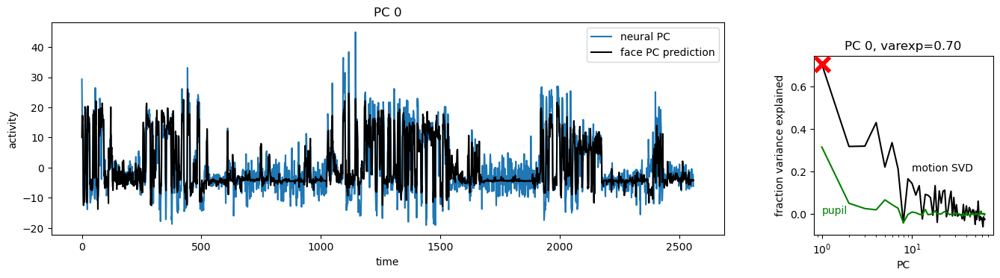

In [ ]:
# plot of principal component activity and variance explained

fig=plt.figure(figsize=(12,3))

ipc = 0 ### which PC to plot

ax = fig.add_axes([0.05,.05,.75,.95])
ax.plot(V[ipc,itest], label='neural PC')
ax.plot(Vpred[ipc], color='k', label='face PC prediction')
ax.set_title('PC %d'%ipc)
ax.set_xlabel('time')
ax.set_ylabel('activity')
ax.legend()

ax = fig.add_axes([0.9,.05, .2, .8])
ax.semilogx(np.arange(1,varexp.size+1), varexp, color='k')
ax.scatter(ipc+1, varexp[ipc],marker='x',color='r',s=200, lw=4, zorder=10)
ax.semilogx(np.arange(1,varexp.size+1), varexp_pupil, color=[0.,.5,0])
ax.text(1,0,'pupil',color=[0,.5,0])
ax.text(10,0.2,'motion SVD')
ax.set_xlabel('PC')
ax.set_ylabel('fraction variance explained')
ax.set_title('PC %d, varexp=%0.2f'%(ipc,varexp[ipc]))
plt.show()

In [ ]:
# sort data by rastermap + smooth
Sfilt = running_average(Sbin[isort][:,itest])
Sfilt = stats.zscore(Sfilt, axis=1)

Spred = np.matmul(U, Vpred)
Sfilt_pred = running_average(Spred[isort, :])
Sfilt_pred = stats.zscore(Sfilt_pred, axis=1)

In [ ]:
np.shape(Vpred)

(64, 2560)

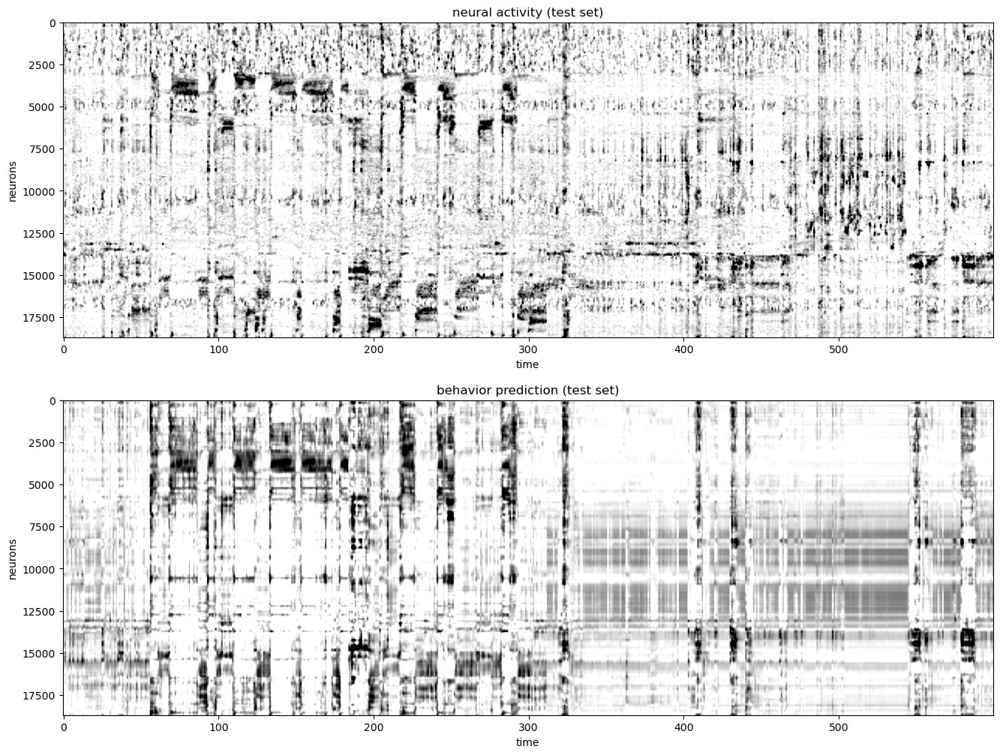

In [ ]:
### plot data + prediction
fig = plt.figure(figsize=(16,12))
ax = fig.add_subplot(2,1,1)
ax.imshow(Sfilt[:,200:800], vmin = -.5, vmax=3, aspect='auto', cmap = 'gray_r')
ax.set_xlabel('time')
ax.set_ylabel('neurons')
ax.set_title('neural activity (test set)')

ax = fig.add_subplot(2,1,2)
ax.imshow(Sfilt_pred[:,200:800], vmin = -.5, vmax=3, aspect='auto', cmap = 'gray_r')
ax.set_xlabel('time')
ax.set_ylabel('neurons')
ax.set_title('behavior prediction (test set)')

plt.show()

how good is the behavioral prediction across the rastermap?

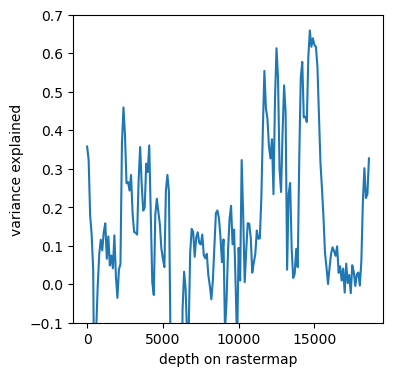

In [ ]:
# bin across the rastermap in groups of 100 neurons
Spbin_pred = np.reshape(Spred[isort][:nc*NC,:], (NC, nc, -1)).mean(axis=1)
Spbin_pred -= Spbin[:,itest]

varexp_RM = 1 - Spbin_pred.var(axis=1) / Spbin.var(axis=1)

#Spbin_pred = zscore(Spbin_pred, axis=1)
#Spbin = zscore(Spbin, axis=1)
#cc = np.matmul(Spbin, Spbin_pred.T) / Spbin.shape[-1]
#cpred = np.diag(cc)

# prediction quality across the rastermap
fig = plt.figure(figsize=(4,4))
ax = fig.add_subplot(1,1,1)
ax.plot(np.arange(0,Spbin.shape[0])*nc, varexp_RM[::-1])
ax.set_ylim([-.1,0.7])
ax.set_ylabel('variance explained')
ax.set_xlabel('depth on rastermap')
plt.show()

In [22]:
from scipy.stats import zscore
from scipy.ndimage import gaussian_filter1d
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy.stats import zscore
import os
import urllib
%matplotlib inline

# download 2-photon data (if not already downloaded)
if not os.path.isfile('data/mesoscope_activity.npy'):
    if not os.path.exists('data'):
        os.mkdir('data')
    response = urllib.request.urlopen('http://www.gatsby.ucl.ac.uk/~cstringer/mesoscope_activity.npy');
    f=open('data/mesoscope_activity.npy','wb')
    f.write(response.read())
    f.close()

# load downloaded data
dat = np.load('data/mesoscope_activity.npy',allow_pickle=True)
dat = dat.item()
sp  = dat['spks']
sp  = zscore(sp, axis=1)
xyloc = dat['xyloc']


In [1]:
savefolder ='C:/Users/hamed/Desktop/Hamed/Github/TP7/results/'
folders=['485']

name='485spikes'
filname=savefolder+name
dats = np.load(filname,allow_pickle=True)
np.shape(dats['sp_data'])


NameError: name 'np' is not defined

In [241]:

names=['485arenaspikes','485task_learningspikes','485task_learnedspikes','485sleep_beforespikes','485sleep_learnedspikes','485sleep_learned_afterspikes']
dats = np.load(filname,allow_pickle=True)

a = np.array([[]] * np.shape(dats['sp_data'])[0])  
savefolder ='C:/Users/hamed/Desktop/Hamed/Github/TP7/results/'

for x in names:
    filname=savefolder+x
    dats = np.load(filname,allow_pickle=True)
    print(x,np.shape(dats['sp_data']))
    #a=np.column_stack((a,dats['sp_data']))# data of all conditions in one matrix



485arenaspikes (219, 5350)
485task_learningspikes (208, 10107)
485task_learnedspikes (289, 11923)
485sleep_beforespikes (250, 25840)
485sleep_learnedspikes (263, 13219)
485sleep_learned_afterspikes (263, 14404)


In [128]:
from scipy.stats import zscore
from scipy.ndimage import gaussian_filter1d
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy.stats import zscore
import os
import urllib
from rastermap import Rastermap
import os # os stands for "operating system" and includes read/write routines etc. 
import numpy as np # by far the most used library for everyday computation
from scipy import stats # here we import a whole sub-library of stats functions
from scipy.ndimage import gaussian_filter, gaussian_filter1d # here we import a single function
from sklearn.decomposition import PCA # check out all the other dimensionality reduction methods in "decomposition"
from matplotlib import pyplot as plt # all of our plotting is done with plt
def running_average(X, nbin = 100):
    Y = np.cumsum(X, axis=0)
    Y = Y[nbin:, :] - Y[:-nbin, :]
    return Y
#savefolder ='C:/Users/hamed/Desktop/Hamed/Github/TP7/results/'
#folders=['481']
savefolder ='C:/Users/hamed/Desktop/Hamed/BCN/sequence/results/'

name='478spikes_sorted'
filname=savefolder+name
dats = np.load(filname,allow_pickle=True)


spks= dats['sp_data']
session_len= np.cumsum(np.ravel(dats['sp_length']))
names= dats['sp_name']
tril_len= dats['sp_trials']
locations= dats['sp_loc']
speed=dats['sp_speed']
seqs=dats['sp_seqs']
poprate=dats['sp_poprate']
id_peaks=dats['sp_idpeak']
id_clusters=dats['sp_clusteridx']+1

trial_len = [x[0] for row in tril_len for x in row]


sp  = zscore(spks, axis=1)
badcells = np.unique(np.argwhere(np.isnan(sp))[:,0])# cells with zero activity
sp[badcells]=0
np.shape(spks)

(205, 177608)

In [78]:
def concate_data(STMx):
    a = np.array([[]] * np.shape(STMx[0])[0])  
    for x in STMx:
        if x.shape[1]>0:
            a=np.column_stack((a,x))# data of all conditions in one matrix
    return a


In [106]:
# session_time = []
# session_time.append(0)
# session_time.extend(session_len)
# session_len_new=[]
# data_dict={}
# i0=0
# names_task=[]
# tasks=['arena','learning_outward','learning_inward','learned_outward','learned_inward'
              
#               ,'learning_reward_L','learning_reward_R','learned_reward_L','learned_reward_R'
#        ,'sleep']
# spk_task=[]
# for tsk in tasks:
#     for ni,nme in enumerate(names):
#         if tsk in nme:
#             names_task.append(nme)
#             spk_task.append(spks[:,session_time[ni]:session_time[ni+1]])
#             session_len_new.append(session_time[ni+1]-session_time[ni])

# spk2=concate_data(spk_task)

# session_len=np.cumsum(session_len_new)
# sp  = zscore(spk2, axis=1)
# names = names_task

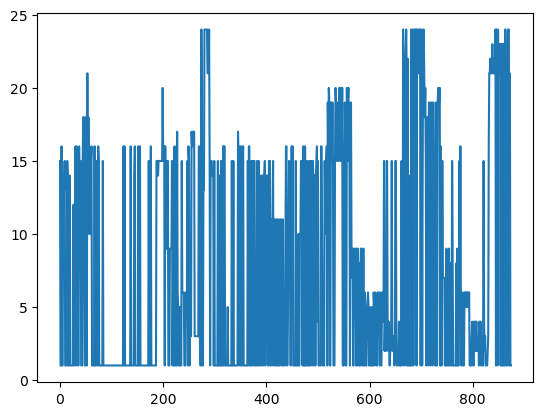

In [119]:
plt.plot(id_clusters)

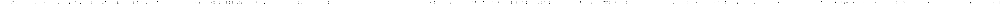

In [86]:
# download 2-photon data (from hannah dataset 485)
# savefolder ='C:/Users/hamed/Desktop/Hamed/Github/TP7/results/'
# folders=['485']
# name='485arena all 485transients'
# filname=savefolder+name
# dat = np.load(filname,allow_pickle=True)
# sp  = zscore(dat, axis=1)
# sp.shape



22

In [5]:
def get_N_HexCol(N=5):
    HSV_tuples = [(x * 1.0 / N, 1-x * .5 / N, .5+x * .5 / N) for x in range(N)]
    tuples = [(x * 1.0 / N, 1-x * .5 / N, .5+x * .5 / N, 1) for x in range(N)]

    hex_out = []
    for rgb in HSV_tuples:
        rgb = map(lambda x: int(x * 255), colorsys.hsv_to_rgb(*rgb))
        hex_out.append('#%02x%02x%02x' % tuple(rgb))
    return hex_out,tuples

AttributeError: 'function' object has no attribute 'ColorbarBase'

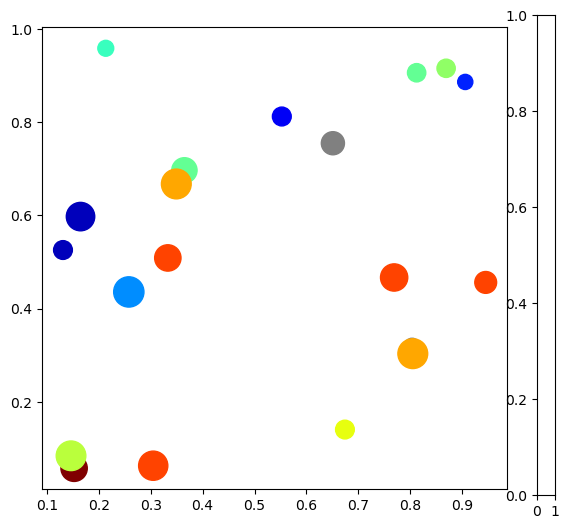

In [132]:
import numpy as np
import matplotlib as mpl
import matplotlib.pylab as plt

fig, ax = plt.subplots(1, 1, figsize=(6, 6))  # setup the plot

x = np.random.rand(20)  # define the data
y = np.random.rand(20)  # define the data
tag = np.random.randint(0, 20, 20)
tag[10:12] = 0  # make sure there are some 0 values to show up as grey

cmap = plt.cm.jet  # define the colormap
# extract all colors from the .jet map
cmaplist = [cmap(i) for i in range(cmap.N)]
# force the first color entry to be grey
cmaplist[0] = (.5, .5, .5, 1.0)

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
bounds = np.linspace(0, 20, 21)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

# make the scatter
scat = ax.scatter(x, y, c=tag, s=np.random.randint(100, 500, 20),
                  cmap=cmap, norm=norm)

# create a second axes for the colorbar
ax2 = fig.add_axes([0.95, 0.1, 0.03, 0.8])
cb = plt.colorbar.ColorbarBase(ax2, cmap=cmap, norm=norm,
    spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

ax.set_title('Well defined discrete colors')
ax2.set_ylabel('Very custom cbar [-]', size=12)

In [157]:
colorlist,colorlist_nbr = get_N_HexCol(N=len(np.unique(id_clusters))+1)

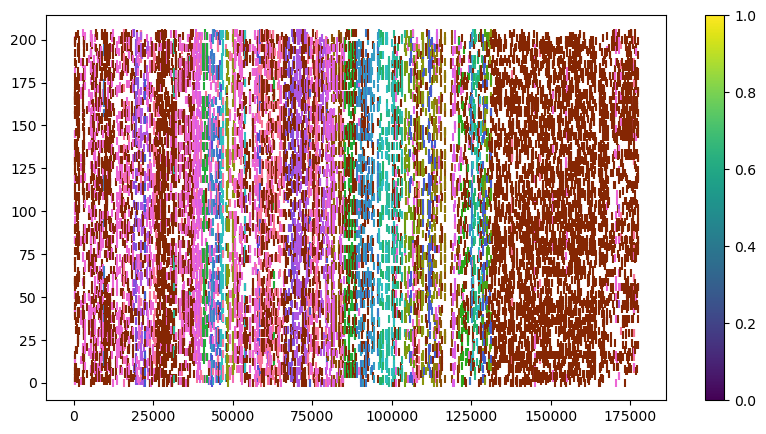

In [134]:
figs=plt.figure(figsize=(10,5))
Seqs=seqs[0:10]
for ix,seq in enumerate(seqs):
    a=np.arange(len(seq))/len(seq)+id_peaks[ix]
    plt.scatter(a,seq,marker='|',color = colorlist[id_clusters[ix]])
#plt.plot((poprate/np.max(poprate)*sp.shape[0]),alpha=.2)
#plt.vlines(id_peaks,0,sp.shape[0],alpha=.5)
#plt.xlim([100,16000])
plt.colorbar(cmap=colorlist)

['#7f0000',
 '#852603',
 '#8b4e06',
 '#907809',
 '#8a960d',
 '#6a9c11',
 '#49a216',
 '#27a81a',
 '#1fad39',
 '#24b365',
 '#2ab992',
 '#2fbfbf',
 '#359dc5',
 '#3b7cca',
 '#425cd0',
 '#5549d6',
 '#8350dc',
 '#af57e2',
 '#db5ee7',
 '#ed66d5',
 '#f36eb7',
 '#f9769a']

In [2]:

# figs=plt.figure(figsize=(50,20))

# ax2=figs.add_axes([0.01,.01,0.9,.9])
# seqmat = np.zeros((spks.shape[0],spks.shape[1]*seqmax))
# for ix in range(len(seqs)):
#         tx=seqs[ix]
#         ty=id_peaks[ix]+np.arange(0,len(seqs[ix]))+seqmax
#         seqmat[tx,ty] = 1
# ax2.imshow(seqmat,vmin =0, vmax=.01, cmap='binary',aspect='auto')
# #plt.plot(poprate)
# plot_sequence_time=True

In [136]:

# rastermap algorithm
# import sys
# sys.path.append('C:/Users/hamed/Desktop/Hame/test/rastermap')
# import mapping, imp
# imp.reload(mapping)

model = Rastermap(n_components=1, n_X=100).fit(sp)


nmin 200
0.12199974060058594
8.198282718658447
8.955426216125488
8.964427709579468
(98, 100)
(130,)
1.0
time; iteration;  explained PC variance
0.01s     0        0.0111      2
0.05s    10        0.0326      4
0.08s    20        0.0605      8
0.12s    30        0.1167      18
0.16s    40        0.1634      28
0.20s    50        0.2031      38
0.25s    60        0.2392      48
0.29s    70        0.2730      58
0.33s    80        0.3063      68
0.38s    90        0.3397      78
0.43s    100        0.3710      88
0.48s    110        0.4012      98
0.52s    120        0.4013      98
0.56s   final      0.4013
0.56s upsampled    0.4013


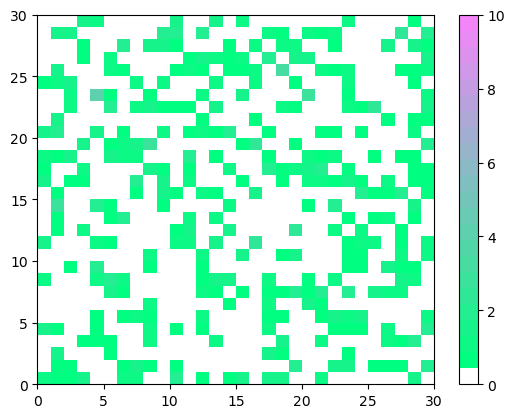

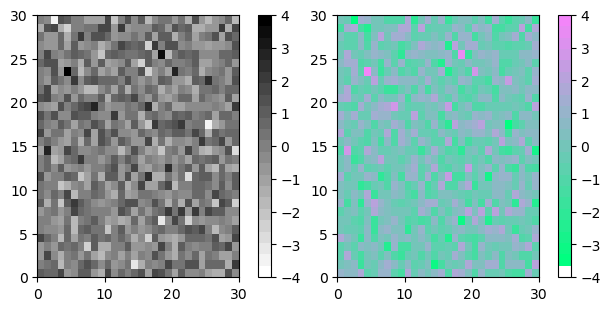

In [159]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
N=len(np.unique(id_clusters))+1
viridis = cm.get_cmap('gray_r', N+1)
newcolors = viridis(np.linspace(0, 1, N+1))
pink = np.array([248/256, 24/256, 148/256, 10])
newcolors[-N:, :] = colorlist_nbr
#newcolors[N:, :] = pink

newcmp = ListedColormap(newcolors)



np.random.seed(19680801)
data = np.random.randn(30, 30)


plt.pcolormesh(data, cmap=newcmp, rasterized=True, vmin=0, vmax=10)
plt.colorbar()

fig, axs = plt.subplots(1, 2, figsize=(6, 3), constrained_layout=True)
for [ax, cmap] in zip(axs, [viridis, newcmp]):
    psm = ax.pcolormesh(data, cmap=cmap, rasterized=True, vmin=-4, vmax=4)
    fig.colorbar(psm, ax=ax)
plt.show()



In [137]:
# compute correlation between speed and each cells activity

isort = np.argsort(model.embedding[:,0])
#Sfilt = running_average(sp[isort, :], 2)
Sfilt=sp[isort, :]
#Sfilt=sp#[isort, :]
speed_corr = [np.corrcoef(x, speed)[0][1] for x in Sfilt]
xloc_corr = [np.corrcoef(x, locations[0,:])[0][1] for x in Sfilt]
yloc_corr = [np.corrcoef(x, locations[1,:])[0][1] for x in Sfilt]

In [138]:
Sfilt2= np.zeros_like(Sfilt)
for i,idpk in enumerate(id_peaks):
    Sfilt2[seqs[i],idpk]=id_clusters[i]

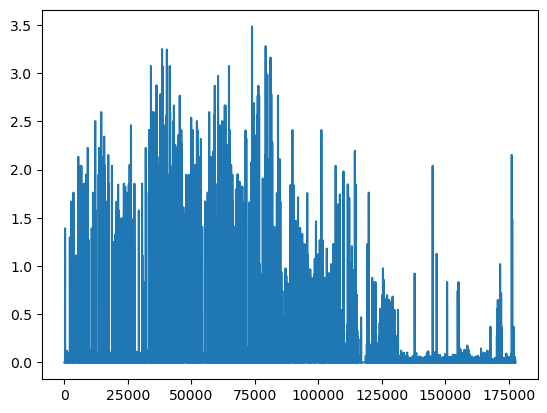

In [139]:
a2=np.mean(Sfilt2,axis=0)
plt.plot(a2)

<Figure size 8000x800 with 0 Axes>

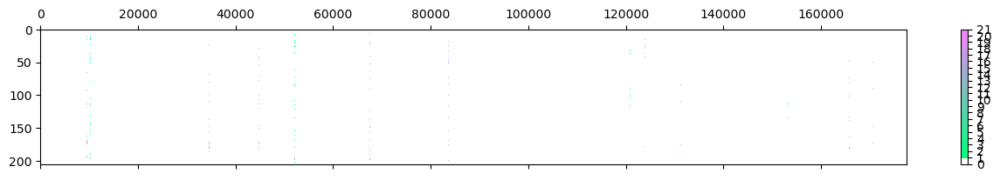

In [189]:
import matplotlib.pyplot as plt
import numpy as np

def discrete_matshow(data):
    # get discrete colormap
    plt.figure(figsize=(100,10),dpi=80)
    cmap = plt.get_cmap('RdBu', np.max(data) - np.min(data) + 1)
    # set limits .5 outside true range
    mat = plt.matshow(data,aspect='auto' ,cmap=newcmp, vmin=np.min(data) , 
                      vmax=np.max(data) )
    # tell the colorbar to tick at integers
    cax = plt.colorbar(mat, ticks=np.arange(np.min(data), np.max(data) + 1))

# generate data
discrete_matshow(Sfilt2)

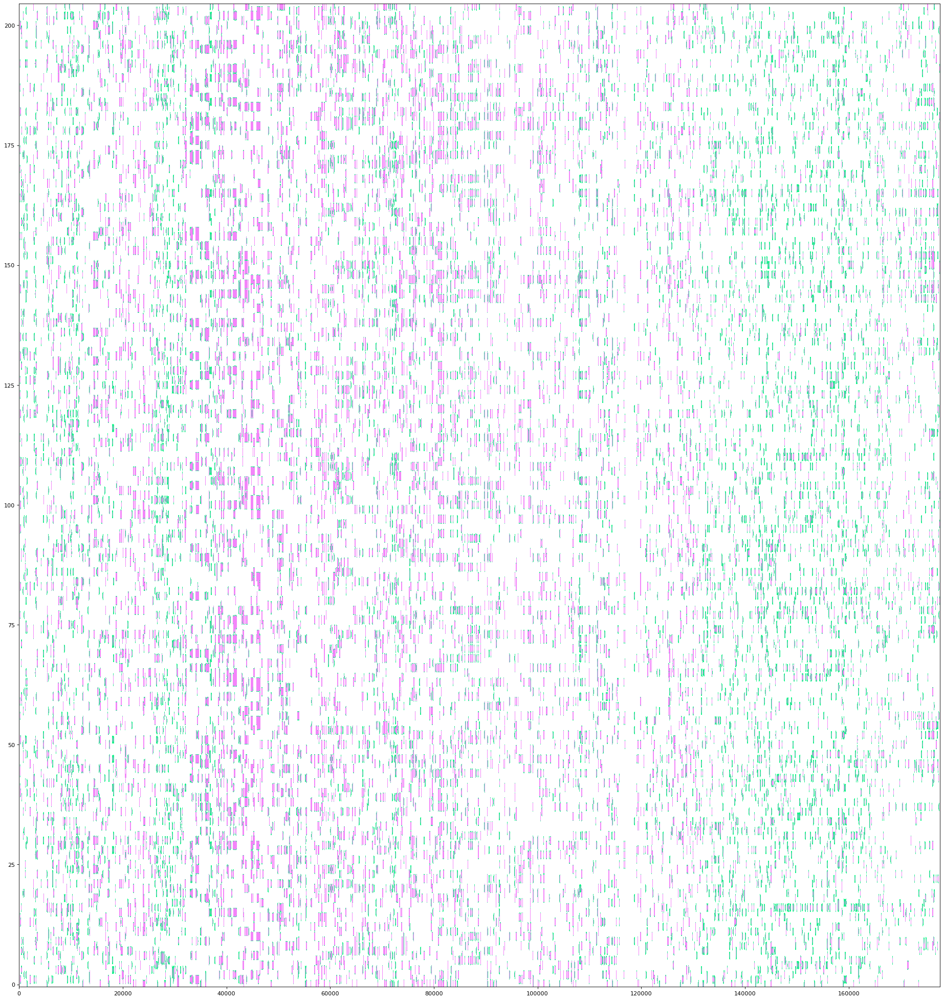

<Figure size 800x800 with 0 Axes>

In [194]:
figs=plt.figure(figsize=(25,40),dpi=80)


ax0=figs.add_axes([0.01,.01,0.9,.6])
from matplotlib import cm
n_colors = N
colours = cm.rainbow(np.linspace(0, 1, n_colors))

ax0.imshow(Sfilt, vmin = 0, vmax=3, aspect='auto', origin='lower',cmap='gray_r',interpolation=None)
ax0.imshow(Sfilt2, vmin = 0, vmax=.010, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)
plt.show()
#plt.colorbar(mat, ticks=np.arange(np.min(Sfilt2), np.max(Sfilt2) + 1))


In [33]:
colorlist[21]

'#f9769a'

In [31]:
id_clusters[ix]

22

([<matplotlib.axis.XTick at 0x17bb23edcd0>,
 [Text(1032, 0, 'arena_inward_L_side65'),
  Text(1901, 0, 'arena_inward_R_side65'),
  Text(2708, 0, 'arena_outward_L_side65'),
  Text(3519, 0, 'arena_outward_R_side65'),
  Text(4176, 0, 'arena_inward_L_side66'),
  Text(5273, 0, 'arena_inward_R_side66'),
  Text(6168, 0, 'arena_outward_L_side66'),
  Text(7280, 0, 'arena_outward_R_side66'),
  Text(8260, 0, 'arena_inward_L_side67'),
  Text(9205, 0, 'arena_inward_R_side67'),
  Text(10352, 0, 'arena_outward_L_side67'),
  Text(11583, 0, 'arena_outward_R_side67'),
  Text(12114, 0, 'task_learning_outward_L_center_78'),
  Text(12597, 0, 'task_learning_outward_L_side_78'),
  Text(12993, 0, 'task_learning_outward_R_center_78'),
  Text(13418, 0, 'task_learning_outward_R_side_78'),
  Text(14247, 0, 'task_learning_outward_L_center_79'),
  Text(15007, 0, 'task_learning_outward_L_side_79'),
  Text(15147, 0, 'task_learning_outward_R_center_79'),
  Text(15359, 0, 'task_learning_outward_R_side_79'),
  Text(16203

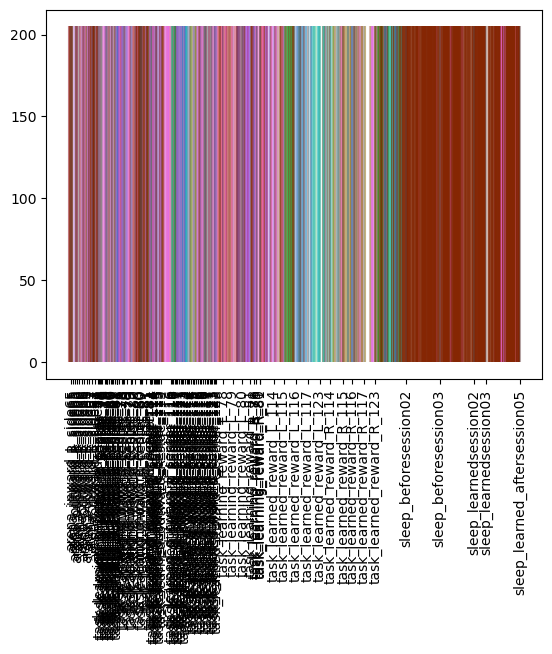

In [201]:
for ix,seq in enumerate(seqs):
    #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
    #plt.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
    plt.vlines(id_peaks[ix],0,np.shape(Sfilt)[0],color=colorlist[id_clusters[ix]],alpha=.3)
plt.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=.2)
plt.xticks(session_len, names, rotation=90)

In [144]:
np.min(Sfilt)

-0.21605417227633714

In [199]:



# the manifold embedding is in model.embedding
fs=20
# sort by embedding and smooth over neurons
#Sfilt = running_average(sp[isort, :], 3)
Sfilt = stats.zscore(Sfilt, axis=1)
xtick_time=np.linspace(0,np.shape(Sfilt)[1],20)
xtick_time_label=(xtick_time/fs)
#xtick_time_label=("["+', '.join(['%.0f']*len(xtick_time_label))+"]") % tuple(xtick_time_label)
figs=plt.figure(figsize=(225,40),dpi=80)

with plt.rc_context({'font.size': 51}):
       ax0=figs.add_axes([0.01,.01,0.9,.6])

       ax0.imshow(Sfilt, vmin =0, vmax=3, aspect='auto', cmap='gray_r',origin='lower')
       plt.xlabel('time s')
       ax0.set_ylabel('sorted neurons')
       #plt.vlines(np.cumsum(trial_len)  ,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=.5)
       plt.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=2)
       ax0.set_xticks(session_len, names, rotation=90)  # Set text labels and properties.
       ax0.set_xticks(xtick_time, xtick_time_label.astype(int), minor=True)  # Set text labels and properties.
       ax0.set_xlim([0,len(locations[1,:])])
       ax1=figs.add_axes([0.01,.91,0.9,.09])
       ax1.plot((locations[0,:]),'g')
       ax1.plot((locations[1,:]),'k')
       ax1.plot(speed,'r')
       ax1.set_xlim([0,len(locations[1,:])])
       ax1.set_xticks([])
       ax1.set_title(name)
       for ix,seq in enumerate(seqs):
          #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          #ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
          ax0.vlines(id_peaks[ix],0,np.shape(Sfilt)[0],color=colorlist[id_clusters[ix]],alpha=.9)
       
       #ax0.imshow(Sfilt2, vmin = 0, vmax=N+1, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)
       #ax0.imshow(Sfilt2, vmin = 0, vmax=.010, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)

       
       ax2=figs.add_axes([0.01,.62,0.9,.29])
       for ix,seq in enumerate(seqs):
          a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          ax2.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
       ax2.set_xticks([])
       #ax2.set_yticks([])
       ax2.set_xlim([0,len(locations[1,:])])
       ax2.plot(poprate/np.max(poprate)*sp.shape[0],alpha=.2)

       #ax0.set_xlim([100,1000])
       #plt.title(name)
       #plt.savefig(savefolder+name+'.pdf',bbox_inches='tight')
       #plt.savefig(savefolder+name+'.png',bbox_inches='tight')
       plt.show(block=0)

In [151]:


# the manifold embedding is in model.embedding
fs=20
# sort by embedding and smooth over neurons
#Sfilt = running_average(sp[isort, :], 3)
Sfilt = stats.zscore(Sfilt, axis=1)
xtick_time=np.linspace(0,np.shape(Sfilt)[1],20)
xtick_time_label=(xtick_time/fs)
#xtick_time_label=("["+', '.join(['%.0f']*len(xtick_time_label))+"]") % tuple(xtick_time_label)
figs=plt.figure(figsize=(50,40),dpi=80)

with plt.rc_context({'font.size': 51}):
       ax0=figs.add_axes([0.01,.01,0.9,.6])

       ax0.imshow(Sfilt, vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r',origin='lower')
       plt.xlabel('time s')
       ax0.set_ylabel('sorted neurons')
       plt.vlines(np.cumsum(trial_len)  ,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=.5)
       plt.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=2)
       ax0.set_xticks(session_len, names, rotation=90)  # Set text labels and properties.
       ax0.set_xticks(xtick_time, xtick_time_label.astype(int), minor=True)  # Set text labels and properties.
       ax0.set_xlim([0,len(locations[1,:])])
       ax1=figs.add_axes([0.01,.91,0.9,.09])
       ax1.plot((locations[0,:]),'g')
       ax1.plot((locations[1,:]),'k')
       ax1.plot(speed,'r')
       ax1.set_xlim([0,len(locations[1,:])])
       ax1.set_xticks([])
       ax1.set_title(name)
       for ix,seq in enumerate(seqs):
          #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          #ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
          ax0.vlines(id_peaks[ix],0,np.shape(Sfilt)[0],color=colorlist[id_clusters[ix]],alpha=.3)
       
       #ax0.imshow(Sfilt2, vmin = 0, vmax=N+1, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)
       
       
       ax2=figs.add_axes([0.01,.62,0.9,.29])
       for ix,seq in enumerate(seqs):
          a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          ax2.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
       ax2.set_xticks([])
       #ax2.set_yticks([])
       ax2.set_xlim([0,len(locations[1,:])])
       ax2.plot(poprate/np.max(poprate)*sp.shape[0],alpha=.2)


       #plt.title(name)
       #plt.savefig(savefolder+name+'.pdf',bbox_inches='tight')
       #plt.savefig(savefolder+name+'.png',bbox_inches='tight')
       plt.show(block=0)

KeyboardInterrupt: 

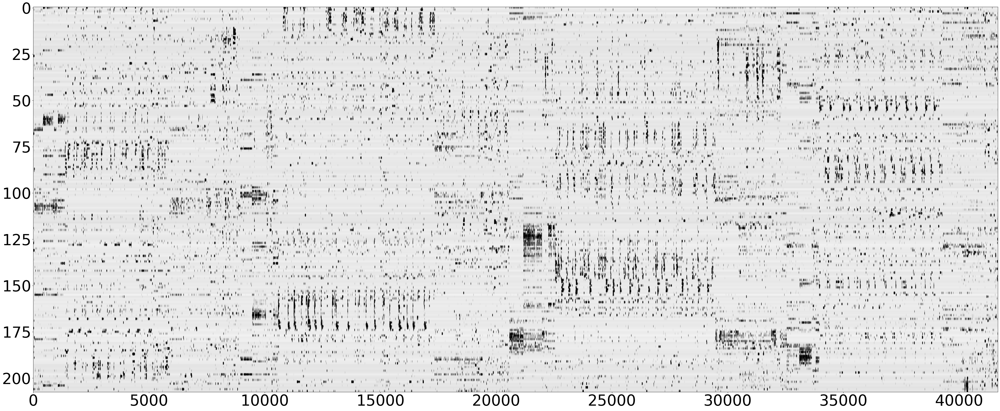

In [47]:

# the manifold embedding is in model.embedding
fs=20
# sort by embedding and smooth over neurons
#Sfilt = running_average(sp[isort, :], 3)
Sfilt = stats.zscore(Sfilt, axis=1)
xtick_time=np.linspace(0,np.shape(Sfilt)[1],20)
xtick_time_label=(xtick_time/fs)
#xtick_time_label=("["+', '.join(['%.0f']*len(xtick_time_label))+"]") % tuple(xtick_time_label)
figs=plt.figure(figsize=(50,40),dpi=80)

with plt.rc_context({'font.size': 51}):
       ax0=figs.add_axes([0.01,.01,0.9,.6])

       ax0.imshow(Sfilt, vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r',origin='lower')
       plt.xlabel('time s')
       ax0.set_ylabel('sorted neurons')
       plt.vlines(np.cumsum(trial_len)  ,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=.5)
       plt.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=2)
       ax0.set_xticks(session_len, names, rotation=90)  # Set text labels and properties.
       ax0.set_xticks(xtick_time, xtick_time_label.astype(int), minor=True)  # Set text labels and properties.
       ax0.set_xlim([0,len(locations[1,:])])
       ax1=figs.add_axes([0.01,.91,0.9,.09])
       ax1.plot((locations[0,:]),'g')
       ax1.plot((locations[1,:]),'k')
       ax1.plot(speed,'r')
       ax1.set_xlim([0,len(locations[1,:])])
       ax1.set_xticks([])
       ax1.set_title(name)
       for ix,seq in enumerate(seqs):
          a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
       
       #ax0.imshow(Sfilt2, vmin = 0, vmax=N+1, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)
       
       
       ax2=figs.add_axes([0.01,.62,0.9,.29])
       for ix,seq in enumerate(seqs):
          a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          ax2.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
       ax2.set_xticks([])
       #ax2.set_yticks([])
       ax2.set_xlim([0,len(locations[1,:])])
       ax2.plot(poprate/np.max(poprate)*sp.shape[0],alpha=.2)


       #plt.title(name)
       #plt.savefig(savefolder+name+'.pdf',bbox_inches='tight')
       #plt.savefig(savefolder+name+'.png',bbox_inches='tight')
       plt.show(block=0)

C:\Users\hamed\AppData\Local\Temp\ipykernel_6544\1347103153.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  plt.xticks(xtick_time, xtick_time, minor=True)  # Set text labels and properties.


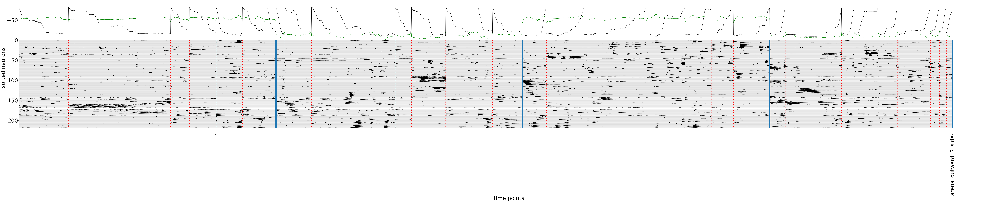

In [70]:

# separate plots
# the manifold embedding is in model.embedding
isort = np.argsort(model.embedding[:,0])
fs=20
# sort by embedding and smooth over neurons
#Sfilt = running_average(sp[isort, :], 3)
Sfilt = stats.zscore(Sfilt, axis=1)
xtick_time=np.linspace(0,np.shape(Sfilt)[1],20)
xtick_time_label=xtick_time/fs

with plt.rc_context({'font.size': 45}):
       ax0=figs.add_axes([0.1,.85,0.5,.05])
       plt.figure(figsize=(146,20))
       plt.imshow(Sfilt, vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r')
       plt.xlabel('time points')
       plt.ylabel('sorted neurons')
       plt.vlines(np.cumsum(trial_len)  ,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=5)
       plt.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=10)
       plt.xticks(session_len, names, rotation=90)  # Set text labels and properties.
       plt.xticks(xtick_time, xtick_time, minor=True)  # Set text labels and properties.

       plt.plot(zscore(locations[0,:])*np.shape(Sfilt)[0]/10-35,'g')
       plt.plot(zscore(locations[1,:])*np.shape(Sfilt)[0]/10-35,'k')



       plt.savefig(savefolder+'arena rastermap .pdf',bbox_inches='tight')
       plt.savefig(savefolder+'arena rastermap.png',bbox_inches='tight')
       plt.show(block=0)

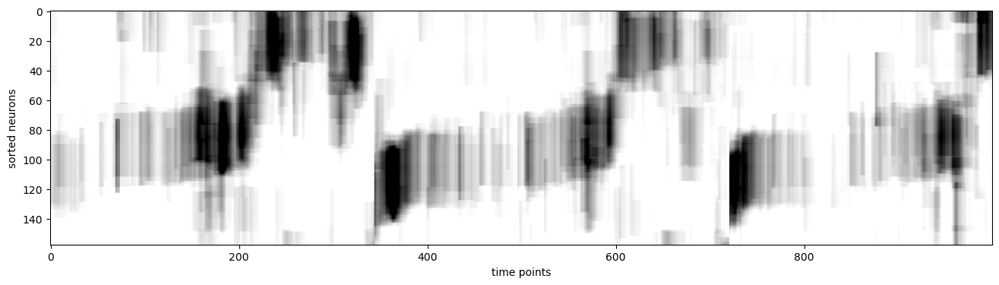

In [182]:
plt.figure(figsize=(16,4))
plt.imshow(Sfilt[:,9000:10000], vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r')
plt.xlabel('time points')
plt.ylabel('sorted neurons')
plt.show()

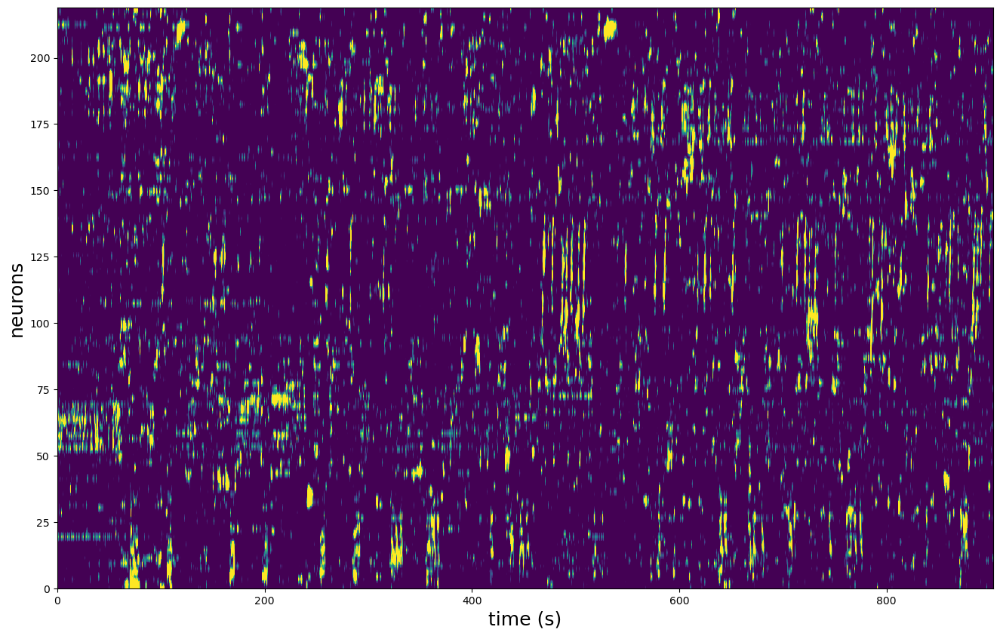

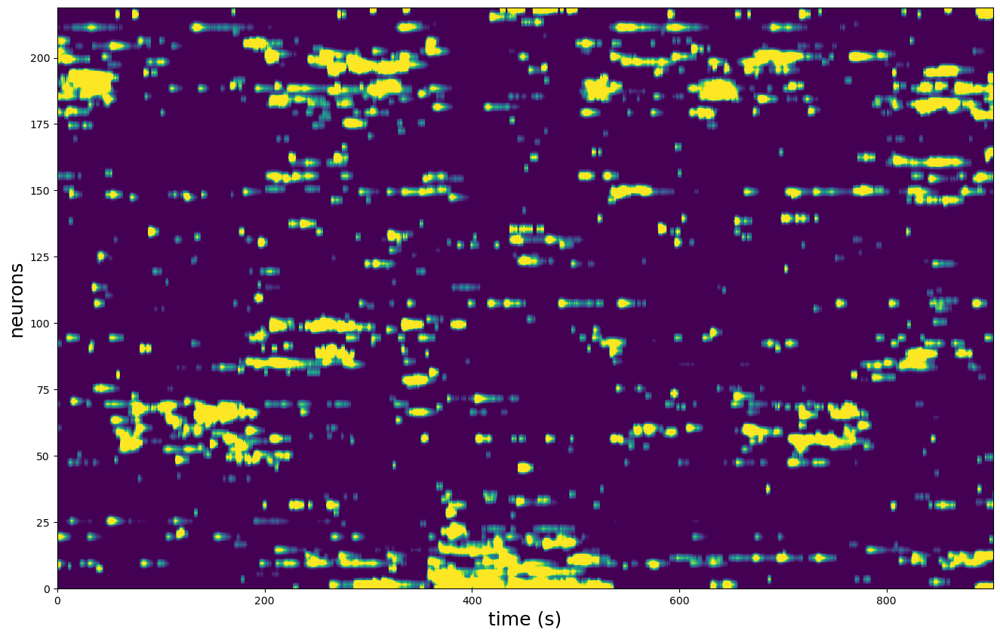

In [118]:
### sort neurons and smooth across neurons and zscore in time
isort = np.argsort(model.embedding[:,0])
Sm = gaussian_filter1d(sp[isort,:].T, np.minimum(3,int(sp.shape[0]*0.005)), axis=1)
Sm = Sm.T

# (optional) smooth in time
#Sm = gaussian_filter1d(Sm, 1, axis=1)
### view neuron sorting
fs = 20 # sampling rate of data in Hz
#splot = Sm[::-1,1500:1800]
splot=Sm
plt.figure(figsize=(16,10))
ax=plt.imshow(splot, vmin=0,vmax=1.5,aspect='auto',extent=[0,splot.shape[1]/fs, 0,splot.shape[0]])
plt.xlabel('time (s)', fontsize=18)
plt.ylabel('neurons', fontsize=18)
plt.show()

plt.figure(figsize=(16,10))
ax=plt.imshow(splot[:,1000:2000], vmin=0,vmax=1.5,aspect='auto',extent=[0,splot.shape[1]/fs, 0,splot.shape[0]])
plt.xlabel('time (s)', fontsize=18)
plt.ylabel('neurons', fontsize=18)
plt.show()